# Python Setup

In [1]:
import numpy as np
from scipy.integrate import quad
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import warnings
%matplotlib notebook
warnings.filterwarnings('ignore')

# 1D - Heat Equation

## Mathematical Background

In this section we will solve the heat equation. Recall that the heat equation is:

\begin{equation}\label{eq:heat_eqn_pde}
    \frac{\partial u}{\partial t}(x, t) = \alpha^{2}\frac{\partial^{2}u}{\partial x^{2}}(x, t)
\end{equation}

where $u = u(x, t)$. To solve the heat equation, we use separation of variables. Let $u(x, t) = X(x)T(t)$. Inserting this form of $u(x, t)$ into the heat equation, we find that:

\begin{equation}
    X\frac{dT}{dt} = \alpha^{2}T\frac{d^{2}X}{dx^{2}}
\end{equation}

Dividing both sides of this equation by $\alpha^{2}X(x)T(t)$, we find:

\begin{equation}
    \frac{1}{\alpha^{2}T}\frac{dT}{dt} = \frac{1}{X}\frac{d^{2}X}{dx^{2}}
\end{equation}

Since both sides of this equation depend on different independent varaibles, both sides must be constant. Let this constant be $-\lambda^{2}$. We thus have two ordinary differential equations:

\begin{equation}
    \frac{d^{2}X}{dx^{2}} = -\lambda^{2}X
\end{equation}
and
\begin{equation}
    \frac{dT}{dt} = -\lambda^{2}\alpha^{2}T
\end{equation}

The solution to the ODE for $T(t)$ is:

\begin{equation}
    T(t) = \exp(-\lambda^{2}\alpha^{2} t)
\end{equation}

The solutions to the ODE governing $X(x)$ are:

\begin{equation}
    X(x) = A\sin(\lambda x) + B\cos(\lambda x)
\end{equation}
or 
\begin{equation}
    X(x) = A\exp(i\lambda x) + B\exp(-i\lambda x)
\end{equation}

At this point, we need to know specific boundary conditions in order to determine the full solution. 

## Boundary Conditions

### Dirichlet BCs

One type of boundary conditions we can have are the so-called *dirichlet boundary conditions*. These boundary conditions are where the solution at the boundaries is fixed. That is, if our interval is $a \leq x \leq b$:

\begin{equation}
    u(x=a, t) = \alpha \ \ \ \ \mathrm{and} \ \ \ \ u(x=b, t) = \beta
\end{equation}

An example of this would be where we fix the temperature at the boundaries to be a constant value, say zero. As an example, let's let $a = 0, b = L$ and $\alpha = \beta = 0$. In this case, the boundaries conditions lead to the following equations for $X(x)$:

\begin{equation}
    0 = X(0) = A\sin(0) + B\cos(0)
\end{equation}
and 
\begin{equation}
    0 = X(L) = A\sin(\lambda L) + B\cos(\lambda L)
\end{equation}

Clearly the first equation gives $B = 0$. The second equation says $0 = A\sin(\lambda L)$. Thus, either $A = 0$ or $\sin(\lambda L) = 0$. If $A = 0$, then $u(x, t) = 0$, which is uninteresting. In the second case, we require that $\lambda L = n\pi$ or $\lambda = n\pi / L$. We thus have eigenvalues $\lambda = \lambda_{n}$ for each integer $n$. For each $n$, we can call the solution to the heat equation $u_{n}(x, t)$, which is equal to:

\begin{equation}
    u_{n}(x, t) = \sin\left(\frac{n\pi x}{L}\right)\exp\left(-\frac{\alpha^{2}n^{2}\pi^{2}t}{L^{2}}\right)
\end{equation}

The general solution is equal to:

\begin{equation}
    u(x, t) = \sum_{n=1}^{\infty}A_{n}\sin\left(\frac{n\pi x}{L}\right)\exp\left(-\frac{\alpha^{2}n^{2}\pi^{2}t}{L^{2}}\right)
\end{equation}


### Neumann BCs

A second type of boundary condition is the neumann boundary condition. In this case, we have boundar conditions specifying the derivative of the function at the boundary. For example:

\begin{equation}
    \frac{\partial u}{\partial x}(x=a, t) = \alpha \ \ \ \ \mathrm{and} \ \ \ \ 
    \frac{\partial u}{\partial x}(x=b, t) = \beta
\end{equation}

As an example, we will set $a = 0, b = L$ and $\alpha = \beta = 0$. In this case we have the following equations for $X(x)$:

\begin{equation}
    0 = X'(0) = \lambda A\cos(0) - \lambda B\sin(0)
\end{equation}
and 
\begin{equation}
    0 = X'(L) = \lambda A\cos(\lambda L) - \lambda B\sin(\lambda L)
\end{equation}

The first equation yields $A = 0$. The second yields $B = 0$ or $\sin(\lambda L) = 0$. As in the case of dirichlet BCs, $B=0$ give the trivial solution $u = 0$, which is boring. The second case gives $\lambda L = n\pi$ or $\lambda = n\pi / L$. The total solution is thus:

\begin{equation}
    u(x, t) = \sum_{n=0}^{\infty}A_{n}\cos\left(\frac{n\pi x}{L}\right)\exp\left(-\frac{\alpha^{2}n^{2}\pi^{2}t}{L^{2}}\right)
\end{equation}


### $t = 0$ Initial Conditions

Our next task is to determine the $A_{n}'s$ from above. To do this, we need to specify $u(x, t=0)$. Given an initial condition at $t=0$, we can determine the $A_{n}'s$ using Fourier's trick (same way we determine the coefficients for Fourier series.) For Dirichlet BCs, we have:

**Dirichlet**
\begin{equation}
    A_{n} = \frac{2}{L}\int_{0}^{L}u(x, t=0)\sin\left(\frac{n\pi x}{L}\right)dx
\end{equation}

In the case of Neumann BCs, we have:

**Neumann**
\begin{equation}
    A_{n} = \frac{2}{L}\int_{0}^{L}u(x, t=0)\cos\left(\frac{n\pi x}{L}\right)dx
\end{equation}

## Implementing in Python

### Dirichlet Boundary Conditions

In [2]:
class HeatEquationDirichlet(object):
    def __init__(self, uinit, alpha, length, num_terms=40):
        self.uinit = uinit
        self.alpha = alpha
        self.length = length
        self.__N = num_terms
        self.ans = self.__compute_ans()
    
    def __an(self, n):
        def integrand(x):
            return self.uinit(x) * np.sin(n * np.pi * x / self.length)
        return 2. / self.length * quad(integrand, 0., self.length)[0]
    
    def __compute_ans(self):
        return np.array([self.__an(n) for n in range(self.__N)])
    
    def u(self, xs, ts):
        xs = np.array(xs)
        ts = np.array(ts)
        
        us = np.zeros((ts.size, xs.size), dtype=float)
        if ts.size == 1:
            us = np.sum(np.array(
                    [self.ans[n] * np.sin(n * np.pi * xs / self.length) * 
                     np.exp(-n**2 * self.alpha**2 * np.pi**2 * ts / self.length**2)
                     for n in range(self.__N)]), axis=0)
        else:
            for i, t in enumerate(ts):
                us[i] = np.sum(np.array(
                    [self.ans[n] * np.sin(n * np.pi * xs / self.length) * 
                     np.exp(-n**2 * self.alpha**2 * np.pi**2 * t / self.length**2)
                     for n in range(self.__N)]), axis=0)
        return us

In [3]:
class HeatEquationNeumann(object):
    def __init__(self, uinit, alpha, length, num_terms=40):
        self.uinit = uinit
        self.alpha = alpha
        self.length = length
        self.__N = num_terms
        self.ans = self.__compute_ans()
    
    def __an(self, n):
        def integrand(x):
            return self.uinit(x) * np.cos(n * np.pi * x / self.length)
        return 2. / self.length * quad(integrand, 0., self.length)[0]
    
    def __compute_ans(self):
        ans = np.array([self.__an(n) for n in range(self.__N)])
        ans[0] = ans[0] / 2.
        return ans
    
    def u(self, xs, ts):
        xs = np.array(xs)
        ts = np.array(ts)
        
        us = np.zeros((ts.size, xs.size), dtype=float)
        if ts.size == 1:
            us = np.sum(np.array(
                    [self.ans[n] * np.cos(n * np.pi * xs / self.length) * 
                     np.exp(-n**2 * self.alpha**2 * np.pi**2 * ts / self.length**2)
                     for n in range(self.__N)]), axis=0)
        else:
            for i, t in enumerate(ts):
                us[i] = np.sum(np.array(
                    [self.ans[n] * np.cos(n * np.pi * xs / self.length) * 
                     np.exp(-n**2 * self.alpha**2 * np.pi**2 * t / self.length**2)
                     for n in range(self.__N)]), axis=0)
        return us

Let's consider the case where we have the following initial condition:
\begin{equation}
    u(x, t=0) = 1.
\end{equation}

First, we construct the `HeatEquationDirichlet` object, which takes in a function for $u(x, t=0)$ as it's first argument, $\alpha$ as the second, $L$ as the third and an optional fourth argument for the number of terms in the to compute in the Fourier series.

In [4]:
def uinit(x):
    return 1.

heat_dirichlet = HeatEquationDirichlet(uinit, 1., 1., num_terms=200)

Now we can make a plot of the temperature as a function of $x$ for various times:

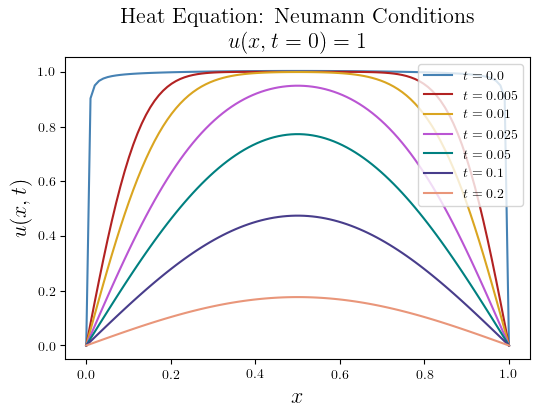

In [5]:
plt.figure(dpi=100)

xs = np.linspace(0.0, heat_dirichlet.length, num=100)
ts = [0.0, 0.005, 0.01, 0.025, 0.05, 0.1, 0.2]
for t in ts:
    plt.plot(xs, heat_dirichlet.u(xs, t), label=r"$t = {}$".format(t))
    
plt.xlabel(r"$x$", fontsize=16)
plt.ylabel(r"$u(x, t)$", fontsize=16)
plt.title("Heat Equation: Neumann Conditions\n" + r"$u(x, t=0) = 1$", fontsize=16)
plt.legend(loc=1)
plt.show()

### Neumann Boundary Conditions

Now we repeat what we did above with Neumann BCs and $u(x, t=0) = x$.

In [6]:
def uinit(x):
    return x

heat_neumann = HeatEquationNeumann(lambda x: x**2, 1., 1., num_terms=200)

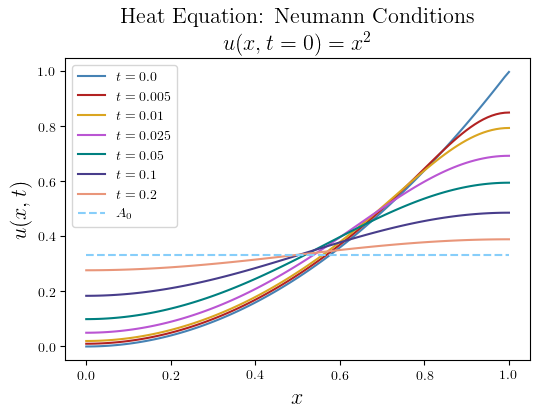

In [7]:
plt.figure(dpi=100)

xs = np.linspace(0.0, heat_dirichlet.length, num=100)
ts = [0.0, 0.005, 0.01, 0.025, 0.05, 0.1, 0.2]
for t in ts:
    plt.plot(xs, heat_neumann.u(xs, t), label=r"$t = {}$".format(t))

plt.plot(xs, [heat_neumann.ans[0] for _ in range(len(xs))], ls='--', label=r"$A_{0}$")
plt.xlabel(r"$x$", fontsize=16)
plt.ylabel(r"$u(x, t)$", fontsize=16)
plt.title("Heat Equation: Neumann Conditions\n" + r"$u(x, t=0) = x^{2}$", fontsize=16)
plt.legend()
plt.show()

## Dynamics

**Dirichlet BCs**

In [14]:
def uinit(x):
    return 1.

heat_dirichlet = HeatEquationDirichlet(uinit, 1., 1., num_terms=200)

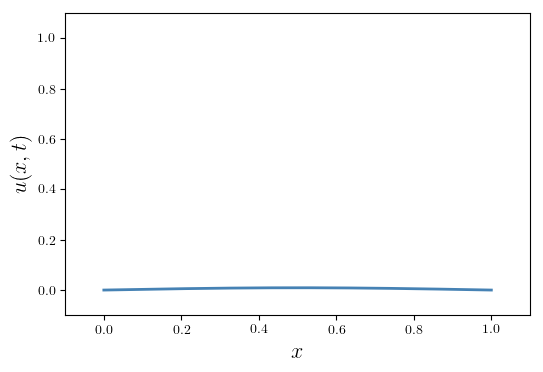

In [15]:
xs = np.linspace(0.0, 1.0, num=200)
ts = np.linspace(0.0, 0.5, num=200)

# First set up the figure, the axis, and the plot element we want to animate
fig = plt.figure(dpi=100);
ax = plt.axes(xlim=(-0.1, 1.1), ylim=(-0.1, 1.1))
ax.set_xlabel(r"$x$", fontsize=16)
ax.set_ylabel(r"$u(x, t)$", fontsize=16)
line, = ax.plot([], [], lw=2);

# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return line,

# animation function.  This is called sequentially
def animate(t):
    ys = heat_dirichlet.u(xs, t)
    line.set_data(xs, ys)
    return line,

# call the animator.  blit=True means only re-draw the parts that have changed.
anim = FuncAnimation(fig, animate, init_func=init,
                               frames=ts, interval=20, blit=True);

HTML(anim.to_jshtml())

**Neumann BCs**

In [10]:
def uinit(x):
    return x

heat_neumann = HeatEquationNeumann(lambda x: x**2, 1., 1., num_terms=200)

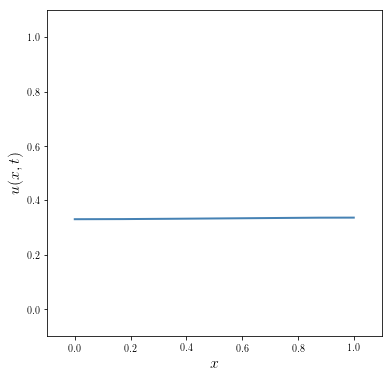

In [16]:
xs = np.linspace(0.0, 1.0, num=200)
ts = np.linspace(0.0, 0.5, num=500)

# First set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots(1, figsize=(6,6))
line, = ax.plot(xs, heat_neumann.u(xs, 0.0), lw=2)

# initialization function: plot the background of each frame
def init():
    ax.set_xlabel(r"$x$", fontsize=16)
    ax.set_ylabel(r"$u(x, t)$", fontsize=16)
    ax.set_ylim([-0.1, 1.1])
    ax.set_xlim([-0.1, 1.1])
    return line,

# animation function.  This is called sequentially
def animate(t):
    ys = heat_neumann.u(xs, t)
    line.set_ydata(ys)
    return line,

# call the animator.  blit=True means only re-draw the parts that have changed.
anim = FuncAnimation(fig, animate, ts, init_func=init,
                     interval=20, blit=True)

HTML(anim.to_jshtml())

# 1D Wave Equation - Vibrating String

In this section we will be solving the 1D wave equation on a finite-length string. The 1D wave equations is:

\begin{equation}
    \frac{1}{v^{2}}\frac{\partial^{2} u}{\partial t^{2}} = \frac{\partial^{2} u}{\partial x^{2}}
\end{equation}

where $u(x,t)$ is the height of the string at position $x$ and time $t$ and $v$ is the velocity of waves traveling on the string (given by the tension and linear mass density of the string.) As we did for the heat equation, we separate variables: $u(x,t) = X(x)T(t)$. The result is:

\begin{equation}
    \frac{1}{v^{2}T}\frac{d^{2}T}{dt^{2}} = \frac{d^{2}X}{dx^{2}} = -k^{2}
\end{equation}

where we have set the seperation constant equal to $-k^{2}$. We thus, find the following ODEs:

\begin{equation}
    X''(x) = -k^{2}x
\end{equation}
and
\begin{equation}
    T''(x) = -v^{2}k^{2}T
\end{equation}

The solution to both of these equations are sines and cosines:

\begin{equation}
    X(x) = A\sin(kx) + B\cos(kx)
\end{equation}
\begin{equation}
    T(t) = C\sin(kvt) + D\cos(kvt)
\end{equation}

To go any further, we will need the boundary conditions of the system.

## Boundary Conditions

Here we discuss the Dirichlet and Neumann boundary conditions for the 1D wave equation discribing a string.

If we have Dirichlet BCs, then we find (as we did for the 1D heat equation) that $k = n\pi/ L$, where $L$ is the length of the string. Then, the solution for $X(x)$ is:

\begin{equation}
    X(x) = A\sin(n\pi x/L)
\end{equation}

If we have Neumann BCs, we again find $k = n\pi/L$ and $X(x)$ is:

\begin{equation}
    X(x) = B\cos(n\pi x/L)
\end{equation}


The general form of the solutions for **Dirichlet BCs** is:

\begin{equation}
    u(x, t) = \sum_{n}\sin(n\pi x/L)\left(A_{n}\sin(n\pi x v t / L) + B_{n}\cos(n\pi x v t / L)\right)
\end{equation}

The general form of the solutions for **Neumann BCs** is:

\begin{equation}
    u(x, t) = \sum_{n}\cos(n\pi x/L)\left(A_{n}\sin(n\pi x v t / L) + B_{n}\cos(n\pi x v t / L)\right)
\end{equation}

Now that we have discussed the spacial BCs, we need to talk about the temporal BCs, i.e. the initial condition. Here we need to specify both the $u(x,t=0)$ *and* $\frac{\partial u}{\partial t}(x, t=0)$. Once we do, we can determine the coefficients $A_{n}$ and $B_{n}$. For **Dirichlet BCs**, we have

\begin{align}
    A_{n} &= \frac{2}{n\pi v}\int_{0}^{L}\sin(n\pi x / L)\partial_{t}u(x,t=0)\\
    B_{n} &= \frac{2}{L}\int_{0}^{L}\sin(n\pi x / L)u(x,t=0)
\end{align}

Note the factor of $1/n\pi v$ in the expression for $A_{n}$. This comes from the fact that $\partial_{t}u(x,t=0)$ is

\begin{equation}
    \partial_{t}u(x, t=0) = \sum_{n}\sin(n\pi x/L)\frac{n\pi v}{L}\left(A_{n}\cos(0) - B_{n}\sin(0)\right) = 
    \sum_{n}A_{n}\frac{n\pi v}{L}\sin(n\pi x/L)
\end{equation}


Multiplying both sides by $\sin(m\pi x / L)$ and integrating from $0$ to $L$, we find

\begin{equation}
    \int_{0}^{L}\partial_{t}u(x,t=0)\sin(m\pi x/L)dx = A_{m}\frac{n\pi v}{L}\frac{L}{2} = 
    A_{m}\frac{n\pi v}{2}
\end{equation}

Solving for $A_{m}$ yields the above equation.

For **Neumann BCs**, you have the same thing but with sine replaced with cosine.

## Python Implementation

In [17]:
class WaveEquation1DDirichlet(object):
    def __init__(self, uinit, duinit, velocity, length, num_terms=40):
        self.uinit = uinit
        self.duinit = duinit
        self.velocity = velocity
        self.length = length
        self.__N = num_terms
        self.ans = self.__compute_ans()
        self.bns = self.__compute_bns()
    
    def __an(self, n):
        def integrand(x):
            return self.duinit(x) * np.sin(n * np.pi * x / self.length)
        return 2. / n / np.pi / self.velocity * quad(integrand, 0., self.length)[0]
    
    def __bn(self, n):
        def integrand(x):
            return self.uinit(x) * np.sin(n * np.pi * x / self.length)
        return 2. / self.length * quad(integrand, 0., self.length)[0]
    
    def __compute_ans(self):
        return np.array([self.__an(n) for n in range(1, self.__N)])
    
    def __compute_bns(self):
        return np.array([self.__bn(n) for n in range(1, self.__N)])
    
    def u(self, xs, ts):
        xs = np.array(xs)
        ts = np.array(ts)
        
        us = np.zeros((ts.size, xs.size), dtype=float)
        if ts.size == 1:
            us = np.sum(np.array(
                    [self.ans[n-1] * np.sin(n * np.pi * xs / self.length) * 
                     np.sin(n * np.pi * self.velocity * ts / self.length)
                     for n in range(1, self.__N)]), axis=0)
            us += np.sum(np.array(
                    [self.bns[n-1] * np.sin(n * np.pi * xs / self.length) * 
                     np.cos(n * np.pi * self.velocity * ts / self.length)
                     for n in range(1, self.__N)]), axis=0)
        else:
            for i, t in enumerate(ts):
                us[i] = np.sum(np.array(
                    [self.ans[n-1] * np.sin(n * np.pi * xs / self.length) * 
                     np.sin(n * np.pi * self.velocity * ts / self.length)
                     for n in range(1, self.__N)]), axis=0)
                us[i] += np.sum(np.array(
                    [self.bns[n-1] * np.sin(n * np.pi * xs / self.length) * 
                     np.cos(n * np.pi * self.velocity * ts / self.length)
                     for n in range(1, self.__N)]), axis=0)
        return us

In [18]:
class WaveEquation1DNeumann(object):
    def __init__(self, uinit, duinit, velocity, length, num_terms=40):
        self.uinit = uinit
        self.duinit = duinit
        self.velocity = velocity
        self.length = length
        self.__N = num_terms
        self.ans = self.__compute_ans()
        self.bns = self.__compute_bns()
    
    def __an(self, n):
        def integrand(x):
            return self.duinit(x) * np.cos(n * np.pi * x / self.length)
        return 2. / n / np.pi / self.velocity * quad(integrand, 0., self.length)[0]
    
    def __bn(self, n):
        def integrand(x):
            return self.uinit(x) * np.cos(n * np.pi * x / self.length)
        return 2. / self.length * quad(integrand, 0., self.length)[0]
    
    def __compute_ans(self):
        ans = np.array([self.__an(n) for n in range(1, self.__N)])
        return ans
    
    def __compute_bns(self):
        bns = np.array([self.__bn(n) for n in range(self.__N)])
        bns[0] = bns[0] / 2.
        return bns
    
    def u(self, xs, ts):
        xs = np.array(xs)
        ts = np.array(ts)
        
        us = np.zeros((ts.size, xs.size), dtype=float)
        if ts.size == 1:
            us = np.sum(np.array(
                    [self.ans[n-1] * np.cos(n * np.pi * xs / self.length) * 
                     np.sin(n * np.pi * self.velocity * ts / self.length)
                     for n in range(1, self.__N)]), axis=0)
            us += np.sum(np.array(
                    [self.bns[n] * np.cos(n * np.pi * xs / self.length) * 
                     np.cos(n * np.pi * self.velocity * ts / self.length)
                     for n in range(self.__N)]), axis=0)
        else:
            for i, t in enumerate(ts):
                us[i] = np.sum(np.array(
                    [self.ans[n-1] * np.cos(n * np.pi * xs / self.length) * 
                     np.sin(n * np.pi * self.velocity * ts / self.length)
                     for n in range(1, self.__N)]), axis=0)
                us[i] += np.sum(np.array(
                    [self.bns[n] * np.cos(n * np.pi * xs / self.length) * 
                     np.cos(n * np.pi * self.velocity * ts / self.length)
                     for n in range(self.__N)]), axis=0)
        return us

### Dirichlet - Fixed Ends

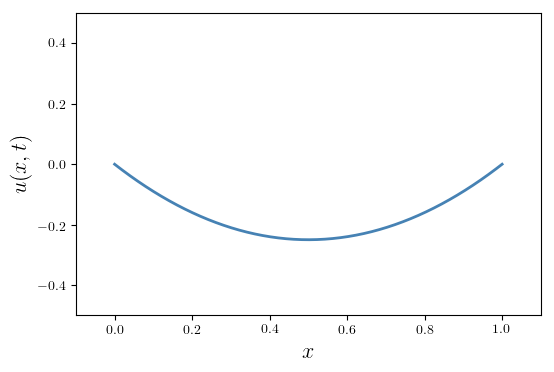

In [20]:
def uinit(x):
    return x * (x - 1.)

def duinit(x):
    return 0.

wave1D_dirichlet = WaveEquation1DDirichlet(uinit, duinit, 1., 1., num_terms=200)

xs = np.linspace(0.0, 1.0, num=200)
ts = np.linspace(0.0, 4.0, num=200)

# First set up the figure, the axis, and the plot element we want to animate
fig = plt.figure(dpi=100);
ax = plt.axes(xlim=(-0.1, 1.1), ylim=(-0.5, 0.5))
ax.set_xlabel(r"$x$", fontsize=16)
ax.set_ylabel(r"$u(x, t)$", fontsize=16)
line, = ax.plot([], [], lw=2);

# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return line,

# animation function.  This is called sequentially
def animate(t):
    ys = wave1D_dirichlet.u(xs, t)
    line.set_data(xs, ys)
    return line,

# call the animator.  blit=True means only re-draw the parts that have changed.
anim = FuncAnimation(fig, animate, init_func=init,
                               frames=ts, interval=20, blit=True);

HTML(anim.to_jshtml())

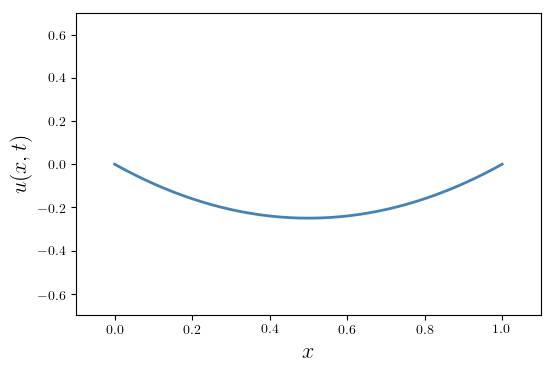

In [21]:
def uinit(x):
    return x * (x - 1.)

def duinit(x):
    return np.exp(-(x-0.25)**2 / 0.05)

wave1D_dirichlet = WaveEquation1DDirichlet(uinit, duinit, 1., 1., num_terms=200)

xs = np.linspace(0.0, 1.0, num=200)
ts = np.linspace(0.0, 4.0, num=200)

# First set up the figure, the axis, and the plot element we want to animate
fig = plt.figure(dpi=100);
ax = plt.axes(xlim=(-0.1, 1.1), ylim=(-0.7, 0.7))
ax.set_xlabel(r"$x$", fontsize=16)
ax.set_ylabel(r"$u(x, t)$", fontsize=16)
line, = ax.plot([], [], lw=2);

# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return line,

# animation function.  This is called sequentially
def animate(t):
    ys = wave1D_dirichlet.u(xs, t)
    line.set_data(xs, ys)
    return line,

# call the animator.  blit=True means only re-draw the parts that have changed.
anim = FuncAnimation(fig, animate, init_func=init,
                               frames=ts, interval=20, blit=True);

HTML(anim.to_jshtml())

### Neumann

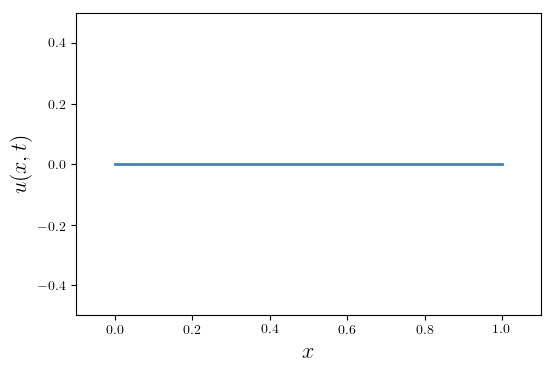

In [22]:
def uinit(x):
    return 0.0

def duinit(x):
    return np.exp(-(x-0.25)**2/0.1) - np.exp(-(x-0.5)**2/0.1)

wave1D_neumann = WaveEquation1DNeumann(uinit, duinit, 1., 1., num_terms=200)

xs = np.linspace(0.0, 1.0, num=200)
ts = np.linspace(0.0, 4.0, num=200)

# First set up the figure, the axis, and the plot element we want to animate
fig = plt.figure(dpi=100);
ax = plt.axes(xlim=(-0.1, 1.1), ylim=(-0.5, 0.5))
ax.set_xlabel(r"$x$", fontsize=16)
ax.set_ylabel(r"$u(x, t)$", fontsize=16)
line, = ax.plot([], [], lw=2);

# initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return line,

# animation function.  This is called sequentially
def animate(t):
    ys = wave1D_neumann.u(xs, t)
    line.set_data(xs, ys)
    return line,

# call the animator.  blit=True means only re-draw the parts that have changed.
anim = FuncAnimation(fig, animate, init_func=init,
                               frames=ts, interval=20, blit=True);

HTML(anim.to_jshtml())

# 2D Wave Equation - Vibrating Membrane

## Background

In this section we will be solving the wave equations on a 2D annulus with inner radius $a$ and outter radius $b$. Our PDE is:

\begin{equation}\label{eq:pde}
    \frac{1}{v^{2}}\frac{\partial^{2}u}{\partial t^{2}} = \nabla^{2}u
\end{equation}

where 

\begin{equation}\label{eq:}
    \nabla^{2}u = \frac{1}{r}\frac{\partial}{\partial r}\left(r\frac{\partial u}{\partial r}\right) + 
                  \frac{1}{r^{2}}\frac{\partial^{2} u}{\partial \theta^{2}}
\end{equation}

Let the boundary conditions be:

\begin{equation}\label{eq:bcs}
    u(r=a,\theta, t) = 0
\end{equation}

and the initial conditions are:

\begin{equation}\label{eq:ics}
    u(r, \theta, t=0) = f(r, \theta)
\end{equation}

where $f(r,\theta)$ is some function of $r$ and $\theta$ that we will specify later. The first step to solving this PDE is to separate variables. Let 

\begin{equation}
    u(r, \theta, t) = R(r)\Theta(\theta)T(t)
\end{equation}

Inserting this into our PDE, we find

\begin{equation}
    \frac{R(r)\Theta(\theta)}{v^{2}}\frac{d^{2}T}{dt^{2}} = \frac{\Theta T}{r}\frac{d}{dr}\left(r\frac{dR}{dr}\right) + \frac{RT}{r^{2}}\frac{d^{2}\Theta}{d\theta^{2}}
\end{equation}

Dividing the entire equation by $u = R\Theta T$, we find

\begin{equation}
    \frac{1}{v^{2}T}\frac{d^{2}T}{dt^{2}} = \frac{1}{rR}\frac{d}{dr}\left(r\frac{dR}{dr}\right) + \frac{1}{r^{2}\Theta}\frac{d^{2}\Theta}{d\theta^{2}}
\end{equation}

The left-hand-side only depends on $t$ while the right-hand-side only depends on $r$ and $\theta$. Thus, both sides must be equal to a constant. Let this constant be $-k^{2}$. Then, we find the following two differential equations:

\begin{equation}
    T'' = -k^{2}v^{2}T
\end{equation}

and
\begin{equation}
    \frac{1}{rR}\frac{d}{dr}\left(r\frac{dR}{dr}\right) + \frac{1}{r^{2}\Theta}\frac{d^{2}\Theta}{d\theta^{2}} = -k^{2}
\end{equation}

The solution to the $T$ equation is:

\begin{equation}
    T(t) = A\sin(k v t) + B\cos(k v t)
\end{equation}

To solve the spacial differential equation, we multiply our differential equation by $r^{2}$ and shift things around, finding:

\begin{equation}
    \frac{r}{R}\frac{d}{dr}\left(r\frac{dR}{dr}\right) + k^{2}r^{2}  = -\frac{1}{\Theta}\frac{d^{2}\Theta}{d\theta^{2}}
\end{equation}

Note that the left and right-hand-sides depend only on $r$ and $\theta$, respectively. Hence, both sides are constant. Call this constant $m^{2}$. Then, we find two ODEs:

\begin{equation}
    r\frac{d}{dr}\left(r\frac{dR}{dr}\right) + (k^{2}r^{2}-m^{2})R = 0
\end{equation}

and

\begin{equation}
    \frac{d^{2}\Theta}{d\theta^{2}} = -m^{2}\Theta
\end{equation}

The solution to the second equation is:

\begin{equation}
    \Theta(\theta) = C\sin(m\theta) + D\cos(m\theta)
\end{equation}

Note that $\theta$ is a periodic varaible. Thus, $\Theta(\theta) = \Theta(\theta + 2\pi)$. This happens only if $m$ is an integer. Lastly, we go the the radial equation. Changing variables to $\rho = kr$, this equation becomes:

\begin{equation}
    \rho^{2}\frac{d^{2}R}{d\rho^{2}} + \rho\frac{dR}{d\rho}+ (\rho^{2}-m^{2})R = 0
\end{equation}

This is just Bessel's differential equation. The solutions are:

\begin{equation}
    R(\rho) = DJ_{m}(\rho) + EY_{m}(\rho)
\end{equation}

or

\begin{equation}
    R(r) = DJ_{m}(kr) + EY_{m}(kr)
\end{equation}

where $J_{m}$ and $Y_{m}$ are the Bessel $m^{\mathrm{th}}$ functions of the first and second kind. In order to meet the boundary conditions $u(r=a,\theta, t) = 0$, we require that $R(r=a) = 0$. Additionally we require that $R(0)$ be finite. Therefore, $E = 0$ since $Y_{m}(r)\to\infty$ as $r\to 0$. To solve $R(r=a) = 0$:

\begin{equation}
    R(a) = DJ_{m}(ka) = 0
\end{equation}

we require that $ka$ be a zero of the $J_{m}$. There are a countably infinite number of zeros of $J_{m}$. Label them by $n$. That is, let $\mu_{mn} = k_{mn}a$ be the $n$th zero of $J_{m}$.

We now have our full solution. The general solution is:

\begin{equation}
    u(r, \theta, t) = \sum_{n, m} J_{m}(\mu_{mn}r/a)\left(C_{mn}\sin(m\theta) + D_{mn}\cos(m\theta)\right)\left(A_{mn}\sin(k_{mn} v t) + B_{mn}\cos(\mu_{mn} v t/a)\right)
\end{equation}

Let us assume that at $t=0$, the derivative of $u(r,\theta, t)$ wrt $t$ is zero. Then, we find that $A_{mn} = 0$. In this case, our solution simplifies to the following form:

\begin{equation}
    u(r, \theta, t) = \sum_{n, m} J_{m}(\mu_{mn}r/a)\left(C_{mn}\sin(m\theta) + D_{mn}\cos(m\theta)\right)\cos(\mu_{mn} v t / a)
\end{equation}

where we have absorbed $A_{mn}$ in $C_{mn}$ and $D_{mn}$. To determine $C_{mn}$ and $D_{mn}$, we need to use the orthogonality relationships of $\sin$ and $\cos$ and the Bessel functions. Using $u(r, \theta, t=0) = f(r, \theta)$, we have

\begin{equation}
    u(r, \theta, 0) = \sum_{n, m} J_{m}(\mu_{mn}r/a)\left(C_{mn}\sin(m\theta) + D_{mn}\cos(m\theta)\right)
\end{equation}

Multiplying both sides by $\sin(m'\theta)$ and integrating over $\theta$, we find

\begin{equation}
    \frac{1}{\pi}\int_{0}^{2\pi}u(r, \theta, 0)\sin(m'\theta)d\theta = \sum_{n} J_{m'}(\mu_{m'n}r/a)C_{m'n}
\end{equation}

Next, we multiply both sides by $rJ_{m'}(\mu_{m'n'}r/a)$ and integrate over $r$ from $0$ to $a$:

\begin{equation}
    C_{m'n'} = \frac{2}{J^{2}_{m'+1}(\mu_{m'n'})}\frac{1}{\pi a^{2}}\int_{0}^{2\pi}\int_{0}^{a}ru(r, \theta, 0)\sin(m'\theta)J_{m'}(\mu_{m'n'}r/a)drd\theta
\end{equation}

Doing the same for $\cos$, we find 

\begin{equation}
    D_{m'n'} = \frac{2}{J^{2}_{m'+1}(\mu_{m'n'})}\frac{1}{\pi a^{2}}\int_{0}^{2\pi}\int_{0}^{a}ru(r, \theta, 0)\cos(m'\theta)J_{m'}(\mu_{m'n'}r/a)drd\theta
\end{equation}

## Implementing in python

In [33]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.special import jn_zeros, jn
from scipy.integrate import dblquad
%matplotlib inline

In [61]:
class VibratingDrumHead(object):
    def __init__(self, uinit, radius=1., velocity=1.):
        self.uinit = uinit
        self.radius = radius
        self.velocity = velocity
        self.dmns = None
        self.cmns = None
        self.jnzeros = np.array([jn_zeros(order, 100) for order in range(100)])
    
    def umn_sin(self, rs, thetas, ts, m, n):
        return (jn(m, self.jnzeros[m][n] * rs / self.radius) * 
                np.sin(m * thetas) * 
                np.cos(self.jnzeros[m][n] * self.velocity * ts / self.radius))
    
    def umn_cos(self, rs, thetas, ts, m, n):
        return (jn(m, self.jnzeros[m][n] * rs / self.radius) * 
                np.cos(m * thetas) * 
                np.cos(self.jnzeros[m][n] * self.velocity * ts / self.radius))
    
    def cmn(self, m, n):
        def integrand(r, theta):
            return (self.uinit(r, theta) * 
                    self.umn_sin(r, theta, 0, m, n) / np.pi**2)
        return dblquad(integrand, 0., 2. * np.pi, 0.0, 1.0)[0]
    
    def dmn(self, m, n):
        def integrand(r, theta):
            return (self.uinit(r, theta) * 
                    self.umn_cos(r, theta, 0, m, n) / np.pi**2)
        return dblquad(integrand, 0., 2. * np.pi, 0.0, 1.0)[0]
    
    def compute_cmns(self):
        self.cmns = np.array([[self.cmn(m, n) 
                               for n in range(20)] 
                              for m in range(20)])
    def compute_dmns(self):
        self.dmns = np.array([[self.dmn(m, n) 
                               for n in range(20)] 
                              for m in range(20)])
    
    def u(self, rs, thetas, t):
        if self.coeff_dmns is None:
            self.compute_dmns()
        if self.coeff_cmns is None:
            self.compute_cmns()
            
        us = np.array([[self.dmns[m][n] * umn_cos(rs, thetas, t, m, n) 
                               for m in range(self.dmns.shape[0])] 
                              for n in range(self.dmns.shape[1])])
        us += np.array([[self.cmns[m][n] * umn_sin(rs, thetas, t, m, n) 
                               for m in range(self.cmns.shape[0])] 
                              for n in range(self.cmns.shape[1])])
        return np.sum(np.sum(us, axis=0), axis=0)
    

In [62]:
def uinit(r, theta):
    return (2. * (1. - r) * np.exp(-100. * (r - 0.5)**2) * 
            np.sin((np.pi / 2.) * np.exp(-50. * (theta - np.pi)**2)))

In [63]:
drum_head = VibratingDrumHead(uinit, radius=1., velocity=1.)

In [ ]:
drum_head.compute_cmns()
drum_head.compute_dmns()

### Eigenmodes

The eigenmodes are of the form:
\begin{equation}
    J_{m}(\mu_{mn}r/a)\sin(m\theta)\cos(\mu_{mn}vt/a)
\end{equation}
and
\begin{equation}
    J_{m}(\mu_{mn}r/a)\sin(m\theta)\sin(\mu_{mn}vt/a)
\end{equation}



In [37]:
# Array of radii from 0.0 to 1.0
rs = np.linspace(0.0, 1.0, num=50)
# Array of thetas from 0.0 to 2pi
thetas = np.linspace(0.0, 2. * np.pi, num=50)

# Create meshgrid for 3D plot
RS, THETAS = np.meshgrid(rs, thetas)

# Compute various eigenmodes
USsin11 = drum_head.umn_sin(RS, THETAS, 0.0, 1, 1)
USsin12 = drum_head.umn_sin(RS, THETAS, 0.0, 1, 2)
USsin13 = drum_head.umn_sin(RS, THETAS, 0.0, 1, 3)

UScos01 = drum_head.umn_cos(RS, THETAS, 0.0, 0, 1)
UScos11 = drum_head.umn_cos(RS, THETAS, 0.0, 1, 1)
UScos12 = drum_head.umn_cos(RS, THETAS, 0.0, 1, 2)

X, Y = RS*np.cos(THETAS), RS*np.sin(THETAS)

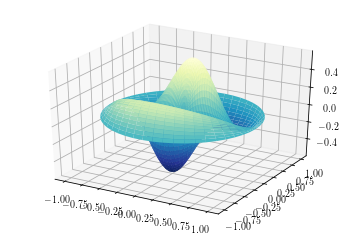

In [39]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X, Y, USsin11, cmap=plt.cm.YlGnBu_r)

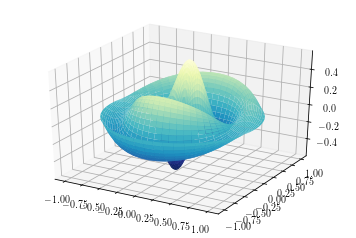

In [40]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X, Y, USsin12, cmap=plt.cm.YlGnBu_r)

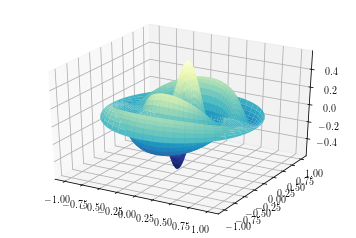

In [42]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X, Y, USsin13, cmap=plt.cm.YlGnBu_r)

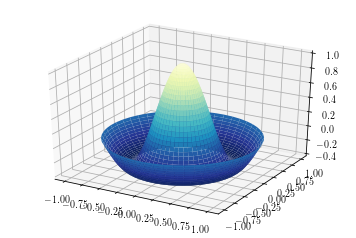

In [45]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X, Y, UScos01, cmap=plt.cm.YlGnBu_r)

### Dynamics

In [57]:
rs = np.linspace(0.0, 1.0, num=50)
thetas = np.linspace(0.0, 2. * np.pi, num=50)
RS, THETAS = np.meshgrid(rs, thetas)

X, Y = RS*np.cos(THETAS), RS*np.sin(THETAS)
US = np.vectorize(drum_head.uinit)(RS, THETAS)

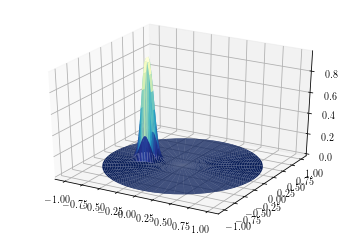

In [58]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X, Y, US, cmap=plt.cm.YlGnBu_r)

In [59]:
rs = np.linspace(0.0, 1.0, num=50)
thetas = np.linspace(0.0, 2. * np.pi, num=50)
RS, THETAS = np.meshgrid(rs, thetas)

X, Y = RS*np.cos(THETAS), RS*np.sin(THETAS)

TypeError: u() takes 3 positional arguments but 4 were given

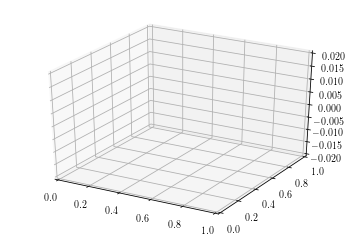

In [60]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.set_zlim([-0.02, 0.02])
ts = np.linspace(0.0, 8.0, num=100)
solns = [drum_head.u(RS, THETAS, t) for t in ts]
plot = ax.plot_surface(X, Y, solns[0])

def data_gen(i, soln, plot):
    soln = solns[i]
    ax.clear()
    ax.set_zlim([-0.02, 0.02])
    plot = ax.plot_surface(X, Y, soln, **plot_args)
    return plot,


pam_ani = animation.FuncAnimation(fig, data_gen, frames=range(1, len(ts)),
                                  fargs=(soln, plot), blit=False)

In [209]:
pam_ani.save('im.mp4')

In [190]:
HTML(pam_ani.to_html5_video())

KeyboardInterrupt: 

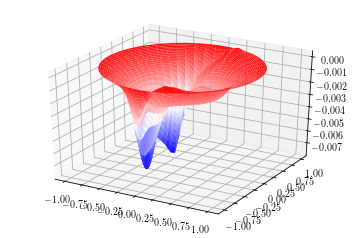

In [187]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
soln = u(RS, THETAS, 4.)
ax.plot_surface(X, Y, soln, **plot_args)